In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


# Visualize `PubLayNet` Dataset.
Example is based on the [test notebook](https://github.com/ibm-aur-nlp/PubLayNet/blob/master/exploring_PubLayNet_dataset.ipynb) present in the [PubLayNet GitHub Repo](https://github.com/ibm-aur-nlp/PubLayNet)

In [ ]:
import sys
import requests
import tarfile
import json
import numpy as np
from os import path
from PIL import Image
from PIL import ImageFont, ImageDraw
from glob import glob
from matplotlib import pyplot as plt

In [ ]:
fname = 'examples.tar.gz'
url = 'https://dax-cdn.cdn.appdomain.cloud/dax-publaynet/1.0.0/' + fname
r = requests.get(url)
open(fname , 'wb').write(r.content)

6461141

In [ ]:
tar = tarfile.open(fname)
tar.extractall()
tar.close()

In [ ]:
# Verifying the file was extracted properly
data_path = "examples/"
path.exists(data_path)

True

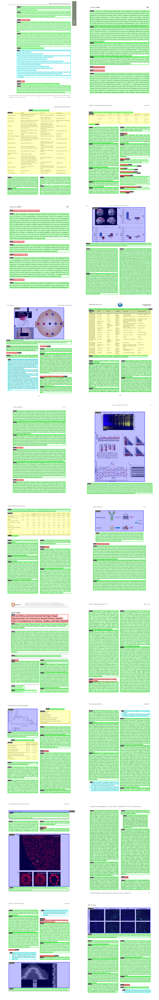

In [ ]:
import json
import numpy as np
import matplotlib.pyplot as plt
from PIL import Image, ImageDraw, ImageFont

# Define color mapping for different categories
colors = {
    'title': (255, 0, 0),
    'text': (0, 255, 0),
    'figure': (0, 0, 255),
    'table': (255, 255, 0),
    'list': (0, 255, 255)
}

# Load JSON file with annotations
with open('examples/samples.json', 'r') as fp:
    samples = json.load(fp)

# Index images
images = {img['id']: {'file_name': "examples/" + img['file_name'], 'annotations': []} for img in samples['images']}

category_map = {cat['id']: cat['name'] for cat in samples['categories']}

for ann in samples['annotations']:
    if ann['image_id'] in images:
        images[ann['image_id']]['annotations'].append(ann)

# Function to visualize annotations
def markup(image, annotations):
    '''Draws segmentation, bounding box, and labels for each annotation.'''
    draw = ImageDraw.Draw(image, 'RGBA')

    for annotation in annotations:
        category_id = annotation['category_id']
        category_name = category_map.get(category_id, "unknown")

        if category_name not in colors:
            continue

        color = colors[category_name] + (64,)

        if 'segmentation' in annotation and annotation['segmentation']:
            draw.polygon(annotation['segmentation'][0], fill=color)

        x, y, w, h = annotation['bbox']
        draw.rectangle([x, y, x + w, y + h], outline=colors[category_name] + (255,), width=2)


        text = category_name
        bbox = draw.textbbox((0, 0), text, font=font)
        text_w, text_h = bbox[2] - bbox[0], bbox[3] - bbox[1]

        label_x, label_y = (x, y) if h > text_h else (x + w, y)

        draw.rectangle([label_x, label_y, label_x + text_w, label_y + text_h], fill=(64, 64, 64, 255))
        draw.text((label_x, label_y), text, fill=(255, 255, 255, 255), font=font)

    return np.array(image)

# Load font for labels
font = ImageFont.truetype("examples/DejaVuSans.ttf", 15)

# Display images with annotations
fig = plt.figure(figsize=(16, 100))
num_images = len(images)
for i, (_, image) in enumerate(images.items()):
    with Image.open(image['file_name']) as img:
        ax = plt.subplot((num_images // 2) + (num_images % 2), 2, i + 1)
        ax.imshow(markup(img, image['annotations']))
        ax.axis('off')

plt.subplots_adjust(hspace=0, wspace=0)
plt.show()


# Download the Dataset
Dataset can be downloaded from the [link](https://developer.ibm.com/exchanges/data/all/publaynet/) present in the [README](https://github.com/ibm-aur-nlp/PubLayNet?tab=readme-ov-file#getting-data) of the repo. The dataset is quite large and for simplicity we are just using the first part of the train dataset (`train-0`).

In [ ]:
!wget -O train-0.tar.gz "https://dax-cdn.cdn.appdomain.cloud/dax-publaynet/1.0.0/train-0.tar.gz"


--2025-03-14 17:14:46--  https://dax-cdn.cdn.appdomain.cloud/dax-publaynet/1.0.0/train-0.tar.gz
Resolving dax-cdn.cdn.appdomain.cloud (dax-cdn.cdn.appdomain.cloud)... 23.65.14.12, 2600:1409:9800:991::d2d, 2600:1409:9800:993::d2d
Connecting to dax-cdn.cdn.appdomain.cloud (dax-cdn.cdn.appdomain.cloud)|23.65.14.12|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 13623987576 (13G) [application/x-gzip]
Saving to: ‘train-0.tar.gz’

train-0.tar.gz      100%[===================>]  12.69G  7.87MB/s    in 17m 23s 

2025-03-14 17:32:09 (12.5 MB/s) - ‘train-0.tar.gz’ saved [13623987576/13623987576]



In [ ]:
!tar -xvzf train-0.tar.gz

Streaming output truncated to the last 5000 lines.
publaynet/train/PMC5395827_00005.jpg
publaynet/train/PMC3562226_00008.jpg
publaynet/train/PMC3940025_00001.jpg
publaynet/train/PMC5824484_00010.jpg
publaynet/train/PMC2918611_00007.jpg
publaynet/train/PMC4662830_00005.jpg
publaynet/train/PMC5807896_00003.jpg
publaynet/train/PMC5630645_00000.jpg
publaynet/train/PMC4912577_00000.jpg
publaynet/train/PMC5712330_00006.jpg
publaynet/train/PMC4659846_00002.jpg
publaynet/train/PMC4764620_00003.jpg
publaynet/train/PMC5630645_00001.jpg
publaynet/train/PMC5712330_00004.jpg
publaynet/train/PMC4273535_00001.jpg
publaynet/train/PMC4273535_00008.jpg
publaynet/train/PMC5741781_00000.jpg
publaynet/train/PMC5216091_00000.jpg
publaynet/train/PMC5818576_00003.jpg
publaynet/train/PMC4999470_00005.jpg
publaynet/train/PMC5395589_00003.jpg
publaynet/train/PMC5906508_00002.jpg
publaynet/train/PMC4691584_00006.jpg
publaynet/train/PMC5906508_00003.jpg
publaynet/train/PMC5487880_00001.jpg
publaynet/train/PMC50825

In [ ]:
category_map[1]

'text'

In [ ]:
!wget -O labels.tar.gz "https://dax-cdn.cdn.appdomain.cloud/dax-publaynet/1.0.0/labels.tar.gz"
!tar -xvzf labels.tar.gz

# here we downloaded the json file just once and then just filtered out the required annotations of the `train-0` dataset
# and saved it in the drive and from here on we are using only the saved filtered-annotations, I did this as this is a time taking process, so to save time I extracted the annotations
# once and then I am using that json file only.

--2025-03-06 14:34:34--  https://dax-cdn.cdn.appdomain.cloud/dax-publaynet/1.0.0/labels.tar.gz
Resolving dax-cdn.cdn.appdomain.cloud (dax-cdn.cdn.appdomain.cloud)... 23.15.97.213, 2600:1413:b000:298::d2d, 2600:1413:b000:289::d2d
Connecting to dax-cdn.cdn.appdomain.cloud (dax-cdn.cdn.appdomain.cloud)|23.15.97.213|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 329162762 (314M) [application/x-gzip]
Saving to: ‘labels.tar.gz’

labels.tar.gz       100%[===================>] 313.91M  70.1MB/s    in 4.6s    

2025-03-06 14:34:38 (68.4 MB/s) - ‘labels.tar.gz’ saved [329162762/329162762]

publaynet/
publaynet/README.txt
publaynet/train.json
publaynet/val.json
publaynet/LICENSE.txt


Extract the annotations corresponding to the `train-0` images from the main "global" JSON file.

In [ ]:
!pip install ijson

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 119.2/119.2 kB 12.2 MB/s eta 0:00:00


In [ ]:
import json
import os
import ijson
from decimal import Decimal

json_path = "/content/publaynet/train.json"
image_folder = "/content/publaynet/train"

image_filenames = set(os.listdir(image_folder))

images = {}

with open(json_path, "r") as fp:
    for image in ijson.items(fp, "images.item"):
        if image["file_name"] in image_filenames:
            images[image["id"]] = {
                "file_name": os.path.join(image_folder, image["file_name"]),
                "annotations": []
            }

with open(json_path, "r") as fp:
    for ann in ijson.items(fp, "annotations.item"):
        if ann["image_id"] in images:
            images[ann["image_id"]]["annotations"].append(ann)


def convert_decimal(obj):
    if isinstance(obj, Decimal):
        return float(obj)
    raise TypeError(f"Type {type(obj)} not serializable")

filtered_json_path = "filtered_annotations.json"
with open(filtered_json_path, "w") as f:
    json.dump(images, f, indent=4, default=convert_decimal)

print(f"Filtered JSON saved as {filtered_json_path}")


Filtered JSON saved as filtered_annotations.json


In [ ]:
# save the annotations in the drive for future use.
!mkdir -p /content/drive/MyDrive/publaynet/
!cp filtered_annotations.json /content/drive/MyDrive/publaynet/

In [ ]:
import os
import json
import random
import shutil

# Paths
image_dir = "/content/publaynet/train"
output_dir = "/content/yolo_dataset"
json_file = "/content/drive/MyDrive/publaynet/filtered_annotations.json"  # try /content/filtered_annotations.json

with open(json_file, "r") as f:
    annotations = json.load(f)

image_filenames = list(annotations.keys())

# Shuffle and split dataset (80% train, 20% val)
random.shuffle(image_filenames)
split_idx = int(0.8 * len(image_filenames))
train_images = set(image_filenames[:split_idx])
val_images = set(image_filenames[split_idx:])

os.makedirs(f"{output_dir}/train/images", exist_ok=True)
os.makedirs(f"{output_dir}/train/labels", exist_ok=True)
os.makedirs(f"{output_dir}/val/images", exist_ok=True)
os.makedirs(f"{output_dir}/val/labels", exist_ok=True)

def filter_annotations(image_set, output_json):
    filtered_data = {}

    for img_id in image_set:
        filtered_data[img_id] = annotations[img_id]

    with open(output_json, "w") as f:
        json.dump(filtered_data, f, indent=4)

filter_annotations(train_images, f"{output_dir}/train/annotations.json")
filter_annotations(val_images, f"{output_dir}/val/annotations.json")


for img_id in image_filenames:
    src = annotations[img_id]["file_name"]
    filename = os.path.basename(src)
    dst_folder = "train" if img_id in train_images else "val"
    dst = os.path.join(output_dir, dst_folder, "images", filename)
    shutil.copy(src, dst)

print("Train-Test Split Completed")


Train-Test Split Completed


In [ ]:
# `PubLayNet` Dataset follows the COCO annotations (source: https://github.com/ibm-aur-nlp/PubLayNet?tab=readme-ov-file#annotation-format)
# So we need it to change to YOLO annotations

import json
import os
from PIL import Image

def coco_to_yolo_bbox(bbox, img_width, img_height):
    x, y, w, h = bbox

    x_center = (x + w / 2) / img_width
    y_center = (y + h / 2) / img_height
    w = w / img_width
    h = h / img_height

    x_center = min(max(x_center, 0), 1)
    y_center = min(max(y_center, 0), 1)
    w = min(max(w, 0), 1)
    h = min(max(h, 0), 1)

    return f"{x_center} {y_center} {w} {h}"

# Convert COCO JSON to YOLO format
def convert_annotations(json_file, output_folder, image_folder):
    with open(json_file, "r") as f:
        data = json.load(f)

    os.makedirs(output_folder, exist_ok=True)

    for img_id, img_data in data.items():
        image_path = img_data["file_name"]
        img_width, img_height = Image.open(image_path).size

        label_file = os.path.join(output_folder, os.path.basename(image_path).replace(".jpg", ".txt"))

        with open(label_file, "w") as f:
            for ann in img_data["annotations"]:
                category_id = ann["category_id"] - 1  # YOLO classes start from 0
                bbox_yolo = coco_to_yolo_bbox(ann["bbox"], img_width, img_height)
                f.write(f"{category_id} {bbox_yolo}\n")

convert_annotations("/content/yolo_dataset/train/annotations.json", "/content/yolo_dataset/train/labels", "/content/yolo_dataset/train/images")
convert_annotations("/content/yolo_dataset/val/annotations.json", "/content/yolo_dataset/val/labels", "/content/yolo_dataset/val/images")

print("COCO-to-YOLO Conversion Completed")


COCO-to-YOLO Conversion Completed


In [ ]:
# Write the data.yaml for the YOLO model
yaml_content = f"""train: /content/yolo_dataset/train/images
val: /content/yolo_dataset/val/images

nc: 5
names: [{category_map[1]}, {category_map[2]}, {category_map[3]}, {category_map[4]}, {category_map[5]}]
"""

# Save file
with open("/content/yolo_dataset/data.yaml", "w") as f:
    f.write(yaml_content)

print("data.yaml created")


data.yaml created


# Train the Model

Install `ultralytics` from where you can import the `YOLO` models. Here we are using `yolov8s` which is the small (just greater than the nano version) version. As the data is quite large (38366 images for train and 9592 images for val), we keep just 5 epochs. The accuracy of the model can be improved by increasing the epochs or using larger models like `yolov8m` or `yolov8l`.

In [ ]:
!pip install ultralytics

# Train YOLOv8 Model
from ultralytics import YOLO

model = YOLO("yolov8s.pt")

model.train(data="/content/yolo_dataset/data.yaml", epochs=5, batch=16)

print("✅ Training Completed!") # added ✅ to match the YOLO output style


   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 922.2/922.2 kB 28.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 363.4/363.4 MB 4.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 13.8/13.8 MB 69.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 24.6/24.6 MB 56.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 883.7/883.7 kB 43.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 664.8/664.8 MB 857.9 kB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 211.5/211.5 MB 5.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.3/56.3 MB 11.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 127.9/127.9 MB 8.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 207.5/207.5 MB 6.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 21.1/21.1 MB 37.4 MB/s eta 0:00:00
  Attempting uninstall: nvidia-nvjitlink-cu12
    Found existing installation: nvidia-nvjitlink-cu12 12.5.82
    Uninsta

100%|██████████| 21.5M/21.5M [00:00<00:00, 110MB/s] 


Ultralytics 8.3.85 🚀 Python-3.11.11 torch-2.5.1+cu124 CUDA:0 (Tesla T4, 15095MiB)
engine/trainer: task=detect, mode=train, model=yolov8s.pt, data=/content/yolo_dataset/data.yaml, epochs=5, time=None, patience=100, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=train, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, embed=None, show=False, save_frames=False, save_txt=False, save_conf=False, save_crop=False, show_labels=True, show_conf=True, show_b

100%|██████████| 755k/755k [00:00<00:00, 25.5MB/s]


Overriding model.yaml nc=80 with nc=5

                   from  n    params  module                                       arguments                     
  0                  -1  1       928  ultralytics.nn.modules.conv.Conv             [3, 32, 3, 2]                 
  1                  -1  1     18560  ultralytics.nn.modules.conv.Conv             [32, 64, 3, 2]                
  2                  -1  1     29056  ultralytics.nn.modules.block.C2f             [64, 64, 1, True]             
  3                  -1  1     73984  ultralytics.nn.modules.conv.Conv             [64, 128, 3, 2]               
  4                  -1  2    197632  ultralytics.nn.modules.block.C2f             [128, 128, 2, True]           
  5                  -1  1    295424  ultralytics.nn.modules.conv.Conv             [128, 256, 3, 2]              
  6                  -1  2    788480  ultralytics.nn.modules.block.C2f             [256, 256, 2, True]           
  7                  -1  1   1180672  ultralytics

100%|██████████| 5.35M/5.35M [00:00<00:00, 104MB/s]


AMP: checks passed ✅


train: Scanning /content/yolo_dataset/train/labels... 38366 images, 0 backgrounds, 0 corrupt: 100%|██████████| 38366/38366 [01:47<00:00, 355.72it/s]

train: WARNING ⚠️ /content/yolo_dataset/train/images/PMC1164428_00003.jpg: 1 duplicate labels removed
train: WARNING ⚠️ /content/yolo_dataset/train/images/PMC1192815_00004.jpg: 1 duplicate labels removed
train: WARNING ⚠️ /content/yolo_dataset/train/images/PMC2435107_00003.jpg: 1 duplicate labels removed
train: WARNING ⚠️ /content/yolo_dataset/train/images/PMC2503986_00002.jpg: 1 duplicate labels removed
train: WARNING ⚠️ /content/yolo_dataset/train/images/PMC2696422_00003.jpg: 1 duplicate labels removed


train: New cache created: /content/yolo_dataset/train/labels.cache
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))


/usr/local/lib/python3.11/dist-packages/albumentations/__init__.py:28: UserWarning: A new version of Albumentations is available: '2.0.5' (you have '2.0.4'). Upgrade using: pip install -U albumentations. To disable automatic update checks, set the environment variable NO_ALBUMENTATIONS_UPDATE to 1.
  check_for_updates()
val: Scanning /content/yolo_dataset/val/labels... 9592 images, 0 backgrounds, 0 corrupt: 100%|██████████| 9592/9592 [00:27<00:00, 350.55it/s]

val: WARNING ⚠️ /content/yolo_dataset/val/images/PMC1363724_00005.jpg: 1 duplicate labels removed
val: WARNING ⚠️ /content/yolo_dataset/val/images/PMC2628921_00004.jpg: 1 duplicate labels removed


val: New cache created: /content/yolo_dataset/val/labels.cache
Plotting labels to runs/detect/train/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.001111, momentum=0.9) with parameter groups 57 weight(decay=0.0), 64 weight(decay=0.0005), 63 bias(decay=0.0)
TensorBoard: model graph visualization added ✅
Image sizes 640 train, 640 val
Using 2 dataloader workers
Logging results to runs/detect/train
Starting training for 5 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


        1/5      3.93G     0.5659     0.6328     0.9162        225        640: 100%|██████████| 2398/2398 [16:06<00:00,  2.48it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 300/300 [01:55<00:00,  2.60it/s]


                   all       9592      93636      0.918      0.871      0.923      0.804

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


        2/5      4.16G     0.4457     0.4292     0.8617        280        640: 100%|██████████| 2398/2398 [15:48<00:00,  2.53it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 300/300 [01:51<00:00,  2.69it/s]


                   all       9592      93636       0.91      0.876      0.917      0.814

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


        3/5      3.87G     0.4113     0.3867      0.851        255        640: 100%|██████████| 2398/2398 [15:38<00:00,  2.55it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 300/300 [01:52<00:00,  2.66it/s]


                   all       9592      93636      0.933      0.901      0.941       0.85

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


        4/5      4.54G     0.3835     0.3518     0.8426        278        640: 100%|██████████| 2398/2398 [15:23<00:00,  2.60it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 300/300 [01:50<00:00,  2.71it/s]


                   all       9592      93636      0.952      0.927      0.964      0.879

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


        5/5      4.56G     0.3564     0.3217     0.8364        276        640: 100%|██████████| 2398/2398 [15:16<00:00,  2.62it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 300/300 [01:50<00:00,  2.71it/s]


                   all       9592      93636      0.953      0.933      0.967      0.884

5 epochs completed in 1.466 hours.
Optimizer stripped from runs/detect/train/weights/last.pt, 22.5MB
Optimizer stripped from runs/detect/train/weights/best.pt, 22.5MB

Validating runs/detect/train/weights/best.pt...
Ultralytics 8.3.85 🚀 Python-3.11.11 torch-2.5.1+cu124 CUDA:0 (Tesla T4, 15095MiB)
Model summary (fused): 72 layers, 11,127,519 parameters, 0 gradients, 28.4 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 300/300 [02:05<00:00,  2.39it/s]


                   all       9592      93636      0.953      0.933      0.967      0.884
                  text       9564      67322      0.969      0.933      0.981      0.926
                 title       7284      17904       0.92       0.96      0.972      0.736
                  list       1492       2245       0.92      0.818      0.905      0.857
                 table       2505       2970      0.974      0.981      0.989      0.948
                figure       2657       3195      0.982      0.976       0.99      0.953
Speed: 0.2ms preprocess, 3.2ms inference, 0.0ms loss, 1.7ms postprocess per image
Results saved to runs/detect/train
✅ Training Completed!


# Testing the pdfs provided in the doc using the model.
We are first changing the pdfs to images using pdf2image and the we pass it to the model for testing.

In [ ]:
!unzip /content/drive/MyDrive/yolo_input_test.zip -d /content/yolo_input_test

Archive:  /content/drive/MyDrive/yolo_input_test.zip
 extracting: /content/yolo_input_test/Test sources/Buendia - Instruccion.pdf  
 extracting: /content/yolo_input_test/Test sources/Constituciones sinodales Calahorra 1602.pdf  
 extracting: /content/yolo_input_test/Test sources/Ezcaray - Vozes.pdf  
 extracting: /content/yolo_input_test/Test sources/Mendo - Principe perfecto.pdf  
 extracting: /content/yolo_input_test/Test sources/Paredes - Reglas generales.pdf  
 extracting: /content/yolo_input_test/Test sources/PORCONES.228.35 тАУ 1636.pdf  


In [ ]:
!ls /content/yolo_input_test/Test_sources/

'Buendia - Instruccion.pdf'		       'Mendo - Principe perfecto.pdf'
'Constituciones sinodales Calahorra 1602.pdf'  'Paredes - Reglas generales.pdf'
'Ezcaray - Vozes.pdf'			       'PORCONES.228.35 тАУ 1636.pdf'


In [ ]:
!apt-get install -y poppler-utils #for pdf2image. Poppler provides the necessary tools to extract images from PDFs.
!pip install pdf2image

Reading package lists... Done
Building dependency tree... Done
Reading state information... Done
The following NEW packages will be installed:
  poppler-utils
0 upgraded, 1 newly installed, 0 to remove and 29 not upgraded.
Need to get 186 kB of archives.
After this operation, 696 kB of additional disk space will be used.
Get:1 http://archive.ubuntu.com/ubuntu jammy-updates/main amd64 poppler-utils amd64 22.02.0-2ubuntu0.6 [186 kB]
Fetched 186 kB in 2s (119 kB/s)
Selecting previously unselected package poppler-utils.
(Reading database ... 125044 files and directories currently installed.)
Preparing to unpack .../poppler-utils_22.02.0-2ubuntu0.6_amd64.deb ...
Unpacking poppler-utils (22.02.0-2ubuntu0.6) ...
Setting up poppler-utils (22.02.0-2ubuntu0.6) ...
Processing triggers for man-db (2.10.2-1) ...


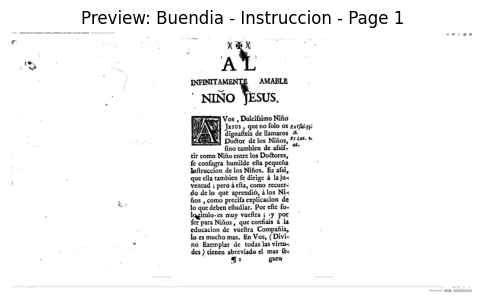

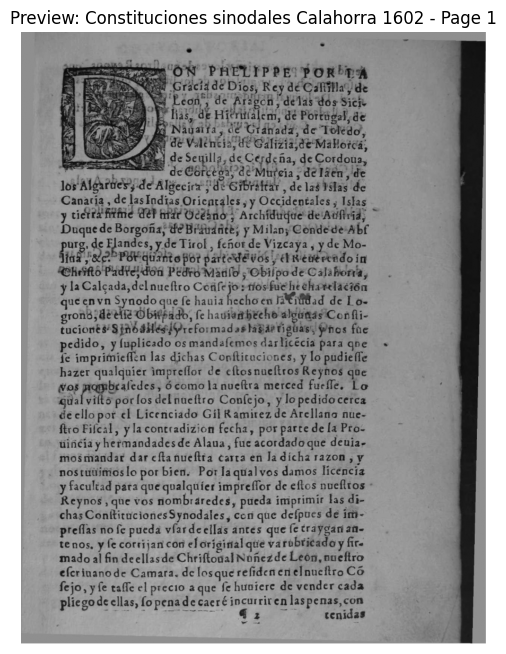

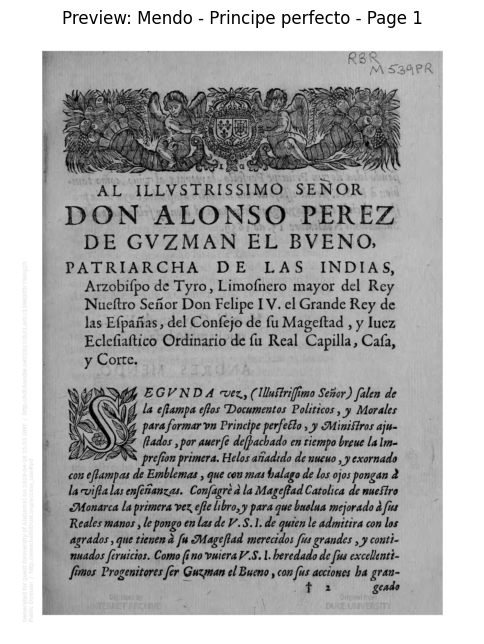

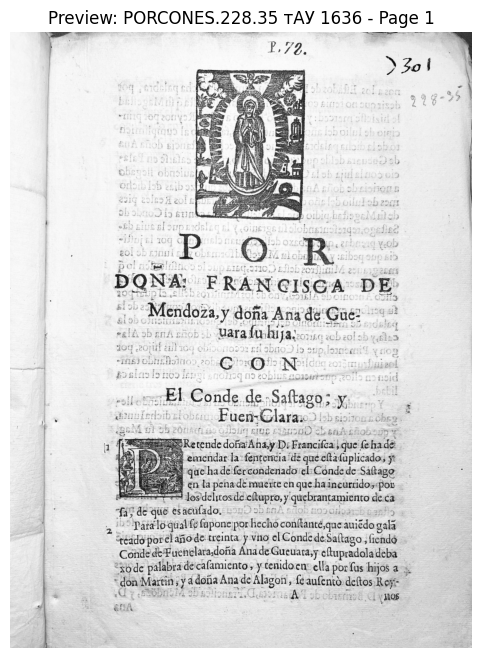

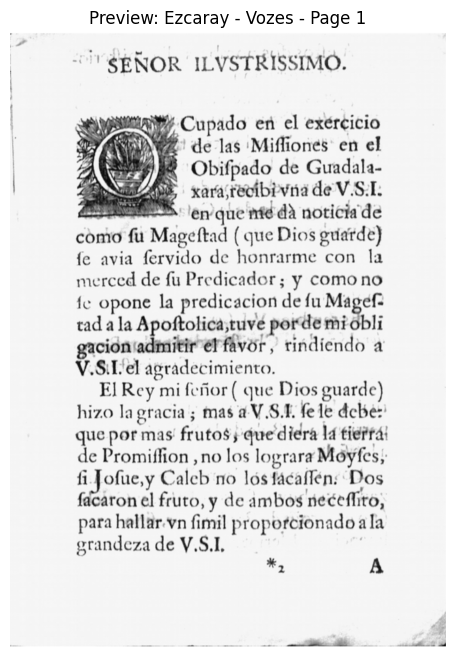

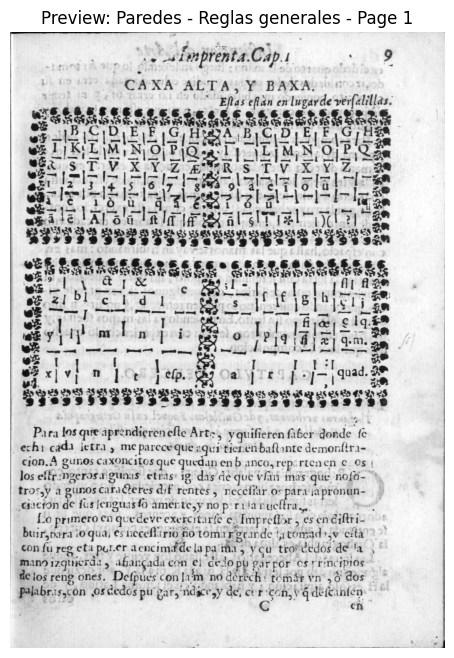

In [ ]:
from pdf2image import convert_from_path
import os
import glob
import cv2
import numpy as np
import matplotlib.pyplot as plt

# Folders
pdf_folder = "/content/yolo_input_test/Test_sources"
image_folder = "/content/yolo_input_test/test_images"
os.makedirs(image_folder, exist_ok=True)

pdf_files = glob.glob(f"{pdf_folder}/*.pdf")

for pdf_path in pdf_files:
    images = convert_from_path(pdf_path, dpi=100, use_pdftocairo=True)
    pdf_name = os.path.splitext(os.path.basename(pdf_path))[0]

    for i, img in enumerate(images):
        # Convert to grayscale (black & white)
        img_cv = np.array(img)
        img_gray = cv2.cvtColor(img_cv, cv2.COLOR_RGB2GRAY)

        img_path = f"{image_folder}/{pdf_name}_page_{i+1}.jpg"
        cv2.imwrite(img_path, img_gray)

        # Plot the first page of each PDF for preview
        if i == 0:
            plt.figure(figsize=(6, 8))
            plt.imshow(img_gray, cmap="gray")
            plt.title(f"Preview: {pdf_name} - Page 1")
            plt.axis("off")
            plt.show()



In [ ]:
# To increase the accuracy of the model, we can preprocess the images by denoising, thresholding, applying CLAHE.

import cv2
import os
from tqdm import tqdm

input_folder = "/content/yolo_input_test/test_images"
output_folder = "/content/preprocessed_images"

os.makedirs(output_folder, exist_ok=True)

def preprocess_image(image_path, output_path):
    image = cv2.imread(image_path, cv2.IMREAD_GRAYSCALE)

    # Apply CLAHE (Contrast Limited Adaptive Histogram Equalization)
    clahe = cv2.createCLAHE(clipLimit=2.0, tileGridSize=(8, 8))
    enhanced_image = clahe.apply(image)

    # Apply OTSU Thresholding
    _, thresh = cv2.threshold(enhanced_image, 0, 255, cv2.THRESH_BINARY + cv2.THRESH_OTSU)

    # Apply Noise Removal (Denoising)
    denoised = cv2.fastNlMeansDenoising(thresh, h=10)

    # Resize to YOLO input size (640x640)
    resized = cv2.resize(denoised, (640, 640))

    cv2.imwrite(output_path, resized)

for filename in tqdm(os.listdir(input_folder)):
    if filename.endswith(".jpg") or filename.endswith(".png"):
        input_path = os.path.join(input_folder, filename)
        output_path = os.path.join(output_folder, filename)
        preprocess_image(input_path, output_path)

print("Preprocessing completed! Processed images are in:", output_folder)


100%|██████████| 57/57 [09:51<00:00, 10.38s/it]

Preprocessing completed! Processed images are in: /content/preprocessed_images


In [ ]:
from ultralytics import YOLO

model = YOLO("/content/best.pt")  # Load trained model
img_folder = "/content/preprocessed_images"
# Run YOLO on extracted images
image_files = glob.glob(f"{img_folder}/*.jpg")
model.predict(image_files, save=True, conf=0.25)

print("Detection complete!")



0: 640x640 1 title, 2 figures, 8.5ms
1: 640x640 2 figures, 8.5ms
2: 640x640 1 text, 2 titles, 1 figure, 8.5ms
3: 640x640 1 figure, 8.5ms
4: 640x640 1 figure, 8.5ms
5: 640x640 6 titles, 1 figure, 8.5ms
6: 640x640 1 figure, 8.5ms
7: 640x640 1 figure, 8.5ms
8: 640x640 1 text, 3 titles, 1 figure, 8.5ms
9: 640x640 (no detections), 8.5ms
10: 640x640 1 figure, 8.5ms
11: 640x640 1 text, 2 titles, 8.5ms
12: 640x640 1 title, 8.5ms
13: 640x640 1 title, 1 figure, 8.5ms
14: 640x640 1 figure, 8.5ms
15: 640x640 1 text, 3 titles, 8.5ms
16: 640x640 (no detections), 8.5ms
17: 640x640 2 figures, 8.5ms
18: 640x640 1 title, 1 figure, 8.5ms
19: 640x640 1 figure, 8.5ms
20: 640x640 2 titles, 8.5ms
21: 640x640 2 titles, 8.5ms
22: 640x640 2 titles, 8.5ms
23: 640x640 1 figure, 8.5ms
24: 640x640 2 titles, 8.5ms
25: 640x640 2 titles, 1 figure, 8.5ms
26: 640x640 1 figure, 8.5ms
27: 640x640 1 figure, 8.5ms
28: 640x640 1 figure, 8.5ms
29: 640x640 1 text, 1 figure, 8.5ms
30: 640x640 3 titles, 1 figure, 8.5ms
31: 640x

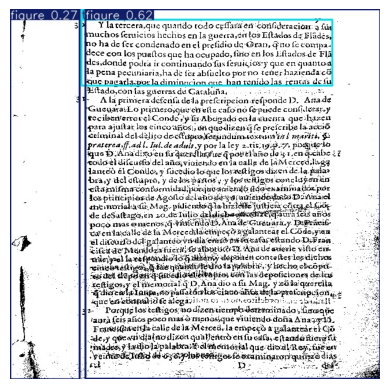

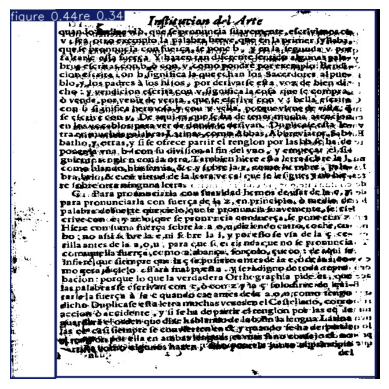

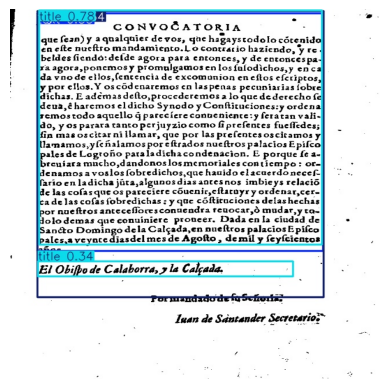

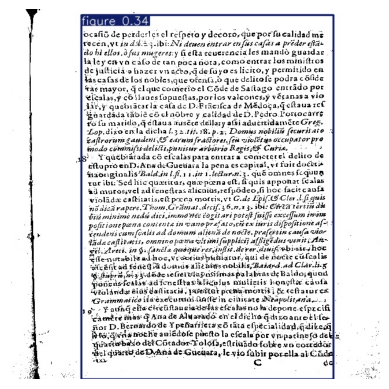

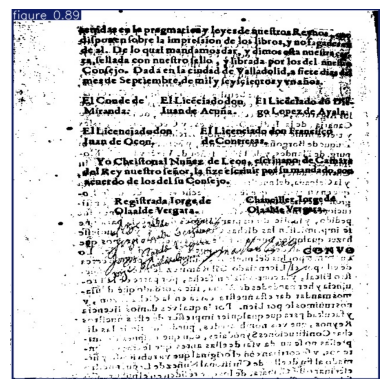

...

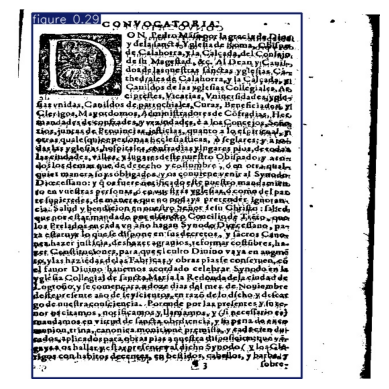

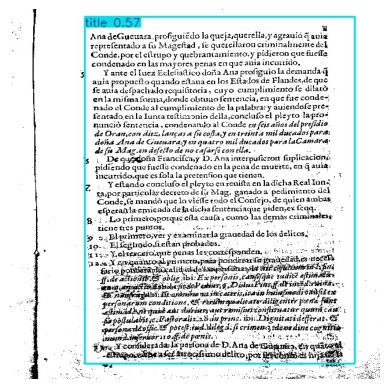

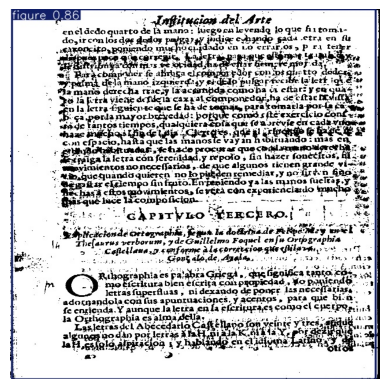

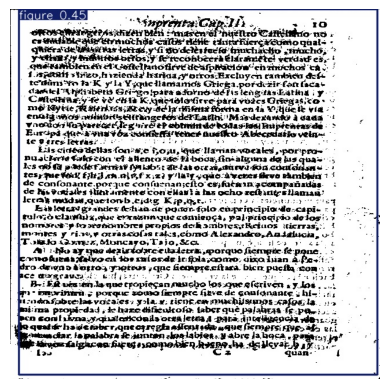

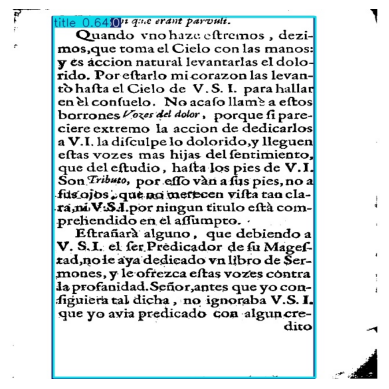

In [ ]:
for img_file in glob.glob("/content/runs/detect/predict2/*.jpg"):
    img = cv2.imread(img_file)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    plt.figure()
    plt.imshow(img)
    plt.axis("off")
    plt.show()
